# Example of usage Spark OCR for Text Detections

This notebook demonstrate pipeline for detect text in image.

## Install spark-ocr python packge
Need to specify:
- secret
- license
- aws credentials

In [1]:
secret = ""
license = ""
AWS_ACCESS_KEY_ID = ""
AWS_SECRET_ACCESS_KEY = ""

version = secret.split("-")[0]
spark_ocr_jar_path = "../../target/scala-2.11/"

In [ ]:
# install from local package 
# %pip install ../../python/dist/spark-ocr-3.10.0+spark30.tar.gz

In [4]:
# install from PYPI using secret
%pip install spark-ocr==$version\.spark30 --extra-index-url=https://pypi.johnsnowlabs.com/$secret --upgrade

In [2]:
import os
import sys

if AWS_ACCESS_KEY_ID != "":
    os.environ["AWS_ACCESS_KEY_ID"] = AWS_ACCESS_KEY_ID
    os.environ["AWS_SECRET_ACCESS_KEY"] = AWS_SECRET_ACCESS_KEY
    
if license:
    os.environ['JSL_OCR_LICENSE'] = license

## Initialization of spark session
Need specify path to `spark-ocr-assembly.jar` or `secret`

In [3]:
from pyspark import SparkConf
from sparkocr import start

spark = start(secret=secret, jar_path = spark_ocr_jar_path)

spark

Spark version: 3.0.2
Spark NLP version: 3.2.3
Spark OCR version: 3.10.0



## Read imageand display it


    Image #0:
    Origin: file:/Users/nmelnik/.local/share/virtualenvs/OcrMissedPages-W3gpzUuJ/lib/python3.7/site-packages/sparkocr/resources/ocr/text_detection/020_Yas_patella.jpg
    Resolution: 72 dpi
    Width: 3024 px
    Height: 4032 px
    Mode: ImageType.TYPE_3BYTE_BGR
    Number of channels: 3


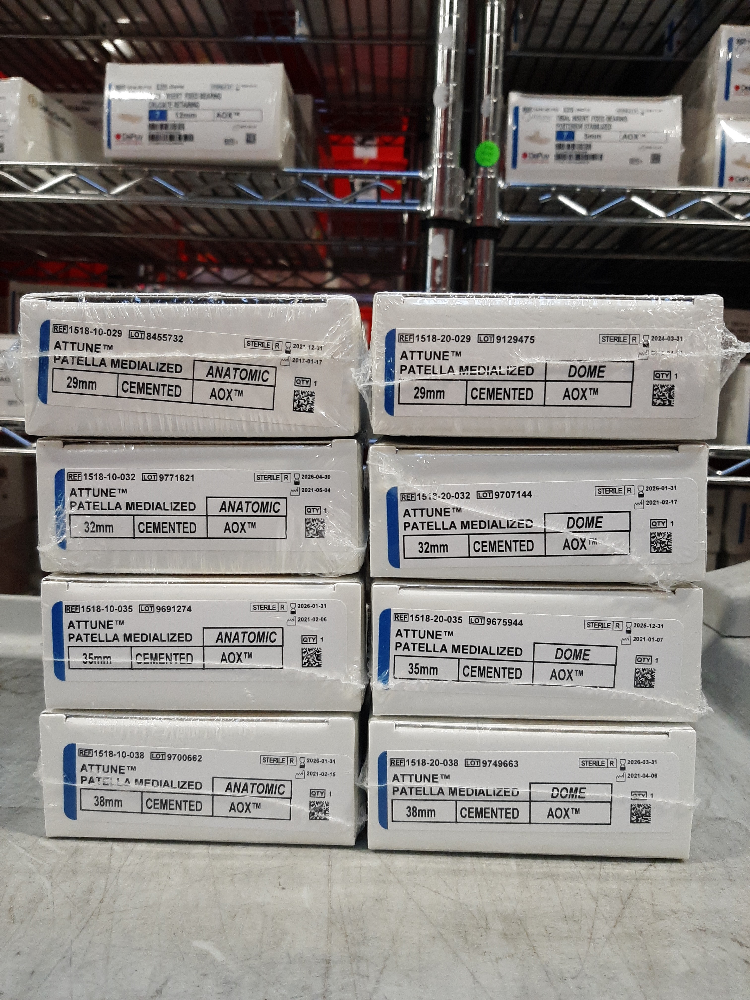

In [4]:
import pkg_resources
from pyspark.ml import PipelineModel
import pyspark.sql.functions as f
from sparkocr.transformers import *
from sparkocr.enums import *
from sparkocr.utils import display_images


imagePath = pkg_resources.resource_filename('sparkocr', 'resources/ocr/text_detection/020_Yas_patella.jpg')

image_df = spark.read.format("binaryFile").load(imagePath)

display_images(BinaryToImage().setImageType(ImageType.TYPE_3BYTE_BGR).transform(image_df), "image")

## Define OCR Pipeline

In [7]:
binary_to_image = BinaryToImage() 
binary_to_image.setImageType(ImageType.TYPE_3BYTE_BGR)

text_detector = ImageTextDetector.pretrained("text_detection_v1", "en", "clinical/ocr")
text_detector.setInputCol("image")
text_detector.setOutputCol("text_regions")
text_detector.setSizeThreshold(3)
text_detector.setScoreThreshold(0.5)
text_detector.setLinkThreshold(0.2)
text_detector.setTextThreshold(0.3)
text_detector.setWidth(816)
text_detector.setHeight(1056)

draw_regions = ImageDrawRegions()
draw_regions.setInputCol("image")
draw_regions.setInputRegionsCol("text_regions")
draw_regions.setOutputCol("image_with_regions")
draw_regions.setRectColor(Color.green)
draw_regions.setRotated(True)

pipeline = PipelineModel(stages=[
    binary_to_image,
    text_detector,
    draw_regions
])

text_detection_v1 download started this may take some time.
Approximate size to download 73.5 MB


## Run pipeline and show results


    Image #0:
    Origin: file:/Users/nmelnik/.local/share/virtualenvs/OcrMissedPages-W3gpzUuJ/lib/python3.7/site-packages/sparkocr/resources/ocr/text_detection/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 3024 px
    Height: 4032 px
    Mode: ImageType.TYPE_3BYTE_BGR
    Number of channels: 3


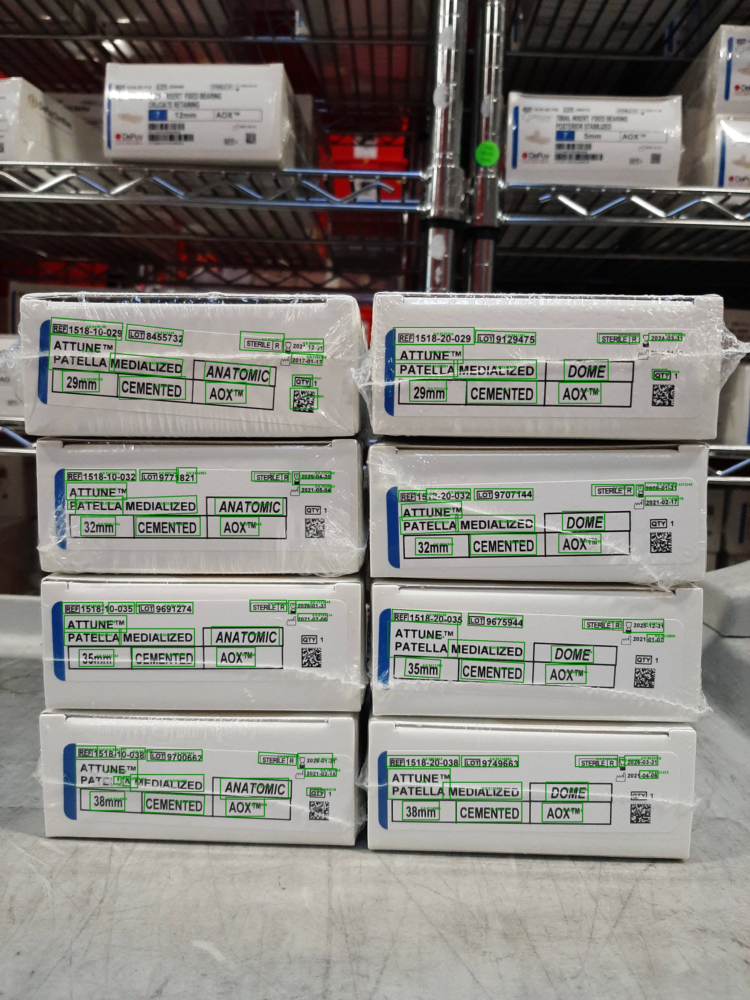

In [8]:
result =  pipeline.transform(image_df).cache()
display_images(result, "image_with_regions")

In [9]:
result.select(f.explode("text_regions")).show(10, False)

+---------------------------------------------------------------------------+
|col                                                                        |
+---------------------------------------------------------------------------+
|[0, 0, 348.4982, 1326.882, 69.13899, 288.89746, 0.9490196, 0, -85.36454]   |
|[0, 0, 623.4434, 1351.0491, 64.988396, 227.22504, 0.9372549, 0, -83.8845]  |
|[0, 0, 1749.1764, 1355.4545, 68.72727, 326.11765, 0.9137255, 0, -90.0]     |
|[0, 0, 2038.4489, 1361.1903, 49.406788, 242.74997, 0.9411765, 0, -87.7974] |
|[0, 0, 1056.1765, 1378.3636, 74.024345, 176.85957, 0.8352941, 0, -86.82017]|
|[0, 0, 2494.0588, 1363.091, 38.181816, 170.47058, 0.8745098, 0, -90.0]     |
|[0, 0, 2683.0588, 1359.2727, 30.545454, 133.41176, 0.7019608, 0, -90.0]    |
|[0, 0, 331.453, 1424.0481, 147.37012, 265.93915, 0.972549, 0, -86.42367]   |
|[0, 0, 1222.9412, 1393.6364, 53.454544, 163.05882, 0.8666667, 0, -90.0]    |
|[0, 0, 1730.6471, 1428.0, 76.36363, 274.2353, 0.92941177, 0, -9

In [10]:
splitter = ImageSplitRegions() \
    .setInputCol("image") \
    .setInputRegionsCol("text_regions") \
    .setOutputCol("text_image") \
    .setDropCols(["image"]) \
    .setExplodeCols(["text_regions"]) \
    .setRotated(True) \
    .setImageType(ImageType.TYPE_BYTE_GRAY)

ocr = ImageToText() \
    .setInputCol("text_image") \
    .setOutputCol("text") \
    .setPageSegMode(PageSegmentationMode.SINGLE_WORD) \
    .setIgnoreResolution(False)


pipelineRec = PipelineModel(stages=[
    splitter,
    ocr
])

In [11]:
recognized = pipelineRec.transform(result).cache()

In [12]:
print(("").join([x.text for x in recognized.select("text").collect()]))

| REFI1518-20-029
‘(RETR
[STERLETR)
2024-03-34
Qz02* 4254
“ATTUNE™
2017-01-17
MEDIALIZED
PATELLA
MEDIALIZED
DOME
ANATOMIC
fan
29mm
lon]
CEMENTED
29mm
CEMENTED
‘AOx™
‘AOX™
EES
REFI1518-10-032
{lo19774
1821
TSTERILETR
| Sd
9026-04-30
2026-01.
31
‘ATTUNE™
2021-05-04
iM
=9_90-032
(00119707144
2021-02-17
ATELLA
SS:
p
ANATOMIC
aes
‘DOME
aa
-MEDIALIZEC
32mm
CEMENTED.
AOX™
CEMENTED
‘AOX™
32mm
[STERILETR
2026-01-37
0-035
(00119691274
{REFI1518-20-035
9021.02.06
[Lom] 9675944
‘ATTUNE™
| STERILETR
GQ 2028-12-31
aie
“ANATOMIC
PATELLA
‘MEDIALIZED
01-07
MEDIALIZED
DOME
CEMENTEN
‘AOX™
35mm
CEMENTED
‘AOX™
REFI1
518.
0-038
‘(26719700662
{STERILE[R.
$2026.01.
| REFI1518-20-038
[0019749663
2026-03-31
Ad
2021-02-15
taal
04-06
A
ANATOMIC
St ol) a
DOME
for
38mm
CEMENTED
AOX™
38mm
“AOX™




    Image #0:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 288 px
    Height: 69 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


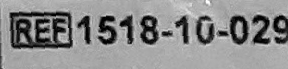


    Image #1:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 227 px
    Height: 64 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


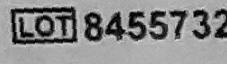


    Image #2:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 326 px
    Height: 68 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


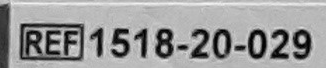


    Image #3:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 242 px
    Height: 49 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


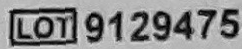


    Image #4:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 176 px
    Height: 74 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


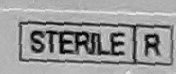


    Image #5:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 170 px
    Height: 38 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


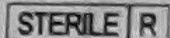


    Image #6:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 133 px
    Height: 30 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1



    Image #7:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 265 px
    Height: 147 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


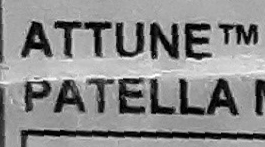


    Image #8:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 163 px
    Height: 53 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


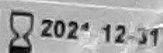


    Image #9:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 274 px
    Height: 76 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


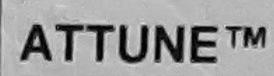


    Image #10:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 124 px
    Height: 41 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


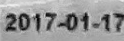


    Image #11:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 292 px
    Height: 74 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


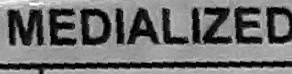


    Image #12:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 252 px
    Height: 68 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


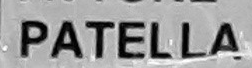


    Image #13:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 333 px
    Height: 76 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


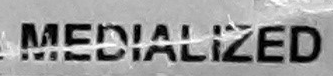


    Image #14:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 177 px
    Height: 84 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


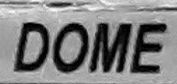


    Image #15:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 263 px
    Height: 79 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


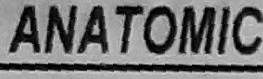


    Image #16:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 59 px
    Height: 38 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


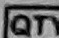


    Image #17:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 148 px
    Height: 84 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


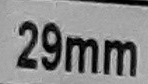


    Image #18:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 81 px
    Height: 45 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


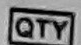


    Image #19:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 266 px
    Height: 91 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


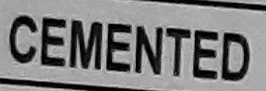


    Image #20:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 148 px
    Height: 84 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


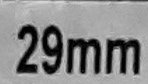


    Image #21:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 281 px
    Height: 91 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


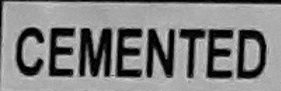


    Image #22:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 163 px
    Height: 84 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


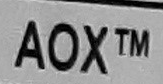


    Image #23:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 170 px
    Height: 84 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


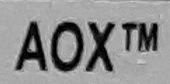


    Image #24:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 111 px
    Height: 84 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


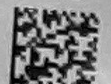


    Image #25:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 289 px
    Height: 45 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


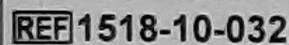


    Image #26:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 155 px
    Height: 45 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


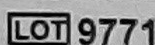


    Image #27:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 81 px
    Height: 61 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


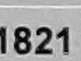


    Image #28:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 148 px
    Height: 38 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


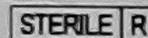


    Image #29:
    Origin: file:/Users/nmelnik/Documents/work/text_detection/examples/020_Yas_patella.jpg
    Resolution: 0 dpi
    Width: 53 px
    Height: 29 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


In [14]:
display_images(recognized, "text_image", limit=30)